# Libraries 

In [1]:
%run "/home/cesar/Python_NBs/HDL_Project/HDL_Project/global_fv.ipynb"

User information is ready!


In [2]:
import plotly.express as px
import seaborn as sns
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller

# User-Defined Functions

In [3]:
def melted_data(data, col_name): 
    features = list(data.columns)
    data = data.reset_index(level=0)    
    data = pd.melt(data, id_vars =['datetime'], value_vars =features)
    data_melt = data.rename(columns = {"variable":col_name})
    return data_melt

In [4]:
def data_vis(data, col_name):
    data = melted_data(data, col_name)
    fig = px.line(data, x='datetime', y="value", color=col_name)
    
    fig.show()

In [5]:
def dtw_analysis(data):
    results = []
    cols = list(data.columns)
    n_cols = len(cols)
    
    for i in cols:
        for j in cols:
            distance, _ = fastdtw(data[i], data[j], dist=euclidean)
            results.append(distance)

    results = np.array(results)
    results = results.reshape((n_cols,n_cols))

    results = pd.DataFrame(results, columns = cols)
    results[" "] = cols
    results = results.set_index(" ")
    return results

In [6]:
def trend_seasonality_df(data):
    count = 0
    for col in list(data.columns):

        decompose_result_mult = seasonal_decompose(data[[col]])

        trend = decompose_result_mult.trend
        seasonal = decompose_result_mult.seasonal

        if count == 0:
            trend_df = pd.DataFrame([trend])
        else:    
            trend_df = trend_df.append(trend, ignore_index=True)

        if count == 0:
            seasonal_df = pd.DataFrame([seasonal])
        else:    
            seasonal_df = seasonal_df.append(seasonal, ignore_index=True)        

        count+=1

    trend_df = trend_df.transpose()
    trend_df.set_axis(list(data.columns), axis=1,inplace=True)

    seasonal_df = seasonal_df.transpose()
    seasonal_df.set_axis(list(data.columns), axis=1,inplace=True)
    
    return trend_df, seasonal_df

In [7]:
def adf_test(data, title = 'Metrics'):
    """
    Augmented Dickey-Fuller test for stationarity
    * p-value > 0.05: Data is non-stationary. Fail to reject the null hypothesis (H0). 
    * p-value <= 0.05: Data is stationary. Reject the null hypothesis (H0).
    """
    
    adf = pd.DataFrame({title:[], "p-value":[], "Stationarity":[]})

    for x in data.columns:
        result = adfuller(data[x])
        p_val = result[1]
        txt = "Non-Stationary" if p_val > 0.05 else "Stationary"
        tmp = pd.DataFrame({title:[x], "p-value":[p_val], "Stationarity":[txt]})
        adf = adf.append(tmp, ignore_index=True)
        adf = adf.sort_values("p-value", ascending = False)
        
    return adf.reset_index(drop = True)

# Data

In [8]:
sql_table = "MVI_sima_station_CE"
target = "pm25"

# Define columns of interest from sql table
#     Select all columns:
column = "*"
#     Select specific columns:
#column = "datetime, prs, rainf, rh, sr, tout, wdr, wsr, " + str(target)

# Filter data with WHERE command
sql_where = "where datetime >= \'2021-03-01\'"

# Number of time steps per sample
n_steps = 24

In [9]:
# Initialize class to create multivariate samples:
multi_ts = multivariate_samples(sql_table, target, column, sql_where)
data = multi_ts.initial_df()

In [10]:
# Quick fix

# 1 ------------------------------------------------------------------------------------------------
# Observations:
# - Zero pressure exists only in a perfect vacuum, and outer space is the only place where this occurs naturally. 
#   This means that these are missing measurements
#   By context, it can be substituted by its surrounding mean values
array_1 = data["prs"]
data["prs"] = np.where(array_1 == 0, array_1[array_1>0].mean(), array_1)


In [11]:
data_dt_index = data.copy()
data = data.reset_index()

In [12]:
data_vis(data, "Time Series")

# Correlation

,no,no2,nox,o3,pm10,pm25,prs,rh,so2,sr,tout,wdr,wsr
no,1.000000,0.721531,0.826825,-0.390985,0.404014,0.354446,0.165458,0.069324,0.365678,0.074348,-0.273262,0.008144,-0.369407
no2,0.721531,1.000000,0.979947,-0.396240,0.469679,0.464610,0.177851,-0.028269,0.483333,-0.146969,-0.444067,0.076069,-0.552683
nox,0.826825,0.979947,1.000000,-0.438456,0.476896,0.463788,0.183990,0.016601,0.467222,-0.104165,-0.425998,0.062480,-0.547581
o3,-0.390985,-0.396240,-0.438456,1.000000,-0.022152,-0.165288,-0.166817,-0.600134,0.048391,0.415766,0.501199,-0.131690,0.653170
pm10,0.404014,0.469679,0.476896,-0.022152,1.000000,0.706402,-0.145720,-0.275932,0.394367,0.214286,-0.007708,-0.006796,-0.093633
pm25,0.354446,0.464610,0.463788,-0.165288,0.706402,1.000000,-0.156459,0.043810,0.335587,0.054766,-0.163984,0.008982,-0.282422
prs,0.165458,0.177851,0.183990,-0.166817,-0.145720,-0.156459,1.000000,0.149462,0.077123,-0.074337,-0.609899,-0.121430,-0.133365
rh,0.069324,-0.028269,0.016601,-0.600134,-0.275932,0.043810,0.149462,1.000000,-0.310180,-0.283922,-0.357853,-0.097680,-0.386275
so2,0.365678,0.483333,0.467222,0.048391,0.394367,0.335587,0.077123,-0.310180,1.000000,0.106575,-0.136480,-0.003788,-0.123345
sr,0.074348,-0.146969,-0.104165,0.415766,0.214286,0.054766,-0.074337,-0.283922,0.106575,1.000000,0.452604,-0.234297,0.349738


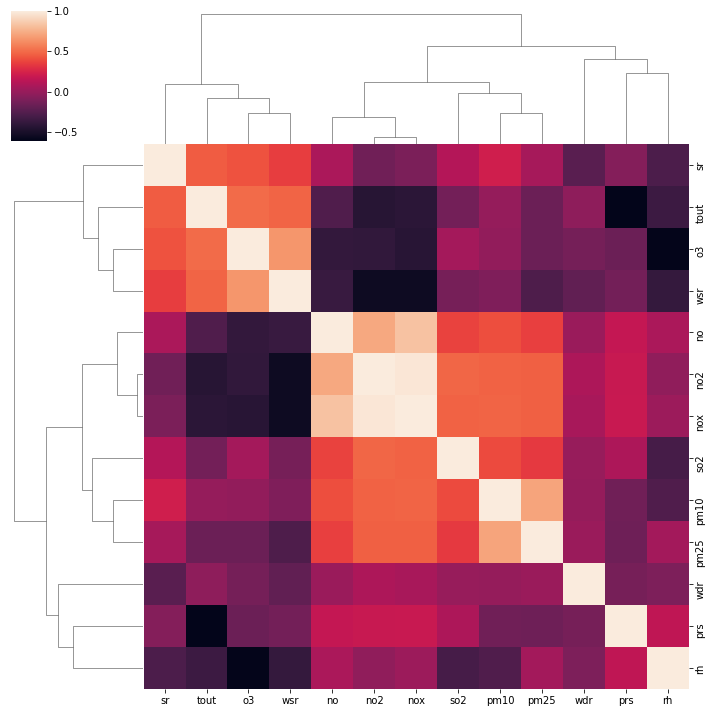

In [13]:
# Spearman correlation is applied if the correlation is thought of as non-linear.
spearman_matrix = data.drop("rainf", axis = 1).corr(method = "spearman")

# Hierarchical clustering for the correlation matrix, where similar time series are placed closer to one another.
sns.clustermap(spearman_matrix)
spearman_matrix

## `* Which of them move similarly?`
Dynamic Time Warping (DTW) to measure similarity between time series, which may vary in speed.

In [14]:
# A matrix with the similarity distance is calculated for every feature.
# The lower the value, the more similar they are.
# Obviously, a feature compared with itself will have the lowest value (0).

results = dtw_analysis(data_dt_index)
results

# Distance time warping analysis (DTW) recognized the minimum distance between SO_2 and PM10
# PM2.5 has minimum distance with NOx

,no,no2,nox,o3,pm10,pm25,prs,rainf,rh,so2,sr,tout,wdr,wsr
,,,,,,,,,,,,,,
no,0.000000,723.137048,561.911991,2602.918900,468.434381,227992.822403,3176.822489,596.313333,4293.827990,387.267262,1615.613293,4767.742696,1894.607770,2082.396187
no2,743.416669,0.000000,569.429000,1622.795029,698.133135,226897.989189,1282.218964,1691.074820,3280.067457,790.526657,1712.647587,3769.753539,1587.269077,1284.645119
nox,564.509162,547.601703,0.000000,2006.842981,571.637302,227432.091741,2013.275344,1156.735335,3817.109118,594.437848,1586.011113,4252.817612,1786.276815,1789.054223
o3,2584.191978,1616.006950,1988.755208,0.000000,2224.011195,225283.930837,1195.657411,3306.878335,1766.935265,2565.048442,1935.205237,1493.469356,1823.904570,951.600021
pm10,457.021714,703.004641,608.234475,2219.450127,0.000000,227724.030011,3170.366599,864.470488,4444.597526,263.610853,1734.012039,4531.707313,1880.180351,1856.651306
pm25,227992.446785,226897.761454,227431.894768,225283.409721,227724.326055,0.000000,224104.906607,228592.122851,222875.392289,227979.585492,226292.567735,222935.064446,225551.151438,225521.352878
prs,3109.819994,1391.940986,2077.081894,1296.128283,3156.968911,224104.881814,0.000000,4488.609411,1512.524908,3529.981495,2384.070438,1148.633319,2320.457393,1408.813602
rainf,596.313333,1691.074820,1156.735335,3306.878335,864.470488,228592.122851,4488.609411,0.000000,5713.318171,609.994190,2297.334425,5656.374167,3040.659436,3069.320049
rh,4326.382441,3343.249768,3794.361072,1880.049559,4393.537458,222875.414512,1522.523367,5713.318171,0.000000,4746.820343,2405.114399,1248.057253,2540.286627,1922.636850


In [15]:
results[results>0].min()

no          383.575494
no2         547.601703
nox         561.911991
o3          965.143357
pm10        264.971542
pm25     222875.414512
prs        1120.779765
rainf       596.313333
rh         1269.487421
so2         263.610853
sr         1586.011113
tout       1148.633319
wdr        1587.269077
wsr         951.600021
dtype: float64

# Trend and seasonality analysis

In [16]:
trend_df, seasonal_df = trend_seasonality_df(data_dt_index.asfreq('H'))

In [17]:
data_vis(trend_df, "Trend")

In [18]:
data_vis(seasonal_df, "Seasonality")
# It has no seasonality

# Stationarity test

In [19]:
adf_test(data_dt_index)

/home/cesar/anaconda3/envs/hdl_project/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:926: RuntimeWarning:

divide by zero encountered in log



,Metrics,p-value,Stationarity
0,no2,5.973081e-10,Stationary
1,so2,1.160276e-11,Stationary
2,tout,7.999527e-12,Stationary
3,nox,5.530710e-12,Stationary
4,sr,2.871900e-14,Stationary
5,wsr,8.147480e-16,Stationary
6,o3,4.312125e-16,Stationary
7,prs,2.716020e-16,Stationary
8,rh,9.201459e-18,Stationary
9,pm10,1.674462e-19,Stationary
